### Imports

In [7]:
# data handling
import numpy    as np
import xarray   as xr

# math
from scipy.stats import norm

# plotting
import matplotlib.pyplot as pyp
import matplotlib.animation as animation
from   IPython.display import HTML
import cmocean

# ray tracing
import mantaray
from mantaray.core import single_ray, ray_tracing

### Helper Functions

In [8]:
g = 9.81
def period2wavenumber(T):
    k = (2*np.pi)**2/g/T**2
    return k

def group_velocity(k):
    cg = 0.5*(g/k)**.5
    return cg

In [9]:
def compute_cfl(x, y, k0):    
    dd = np.min([np.diff(x).mean(), np.diff(y).mean()])
    cg = group_velocity(k0)
    cfl = dd/cg
    return cfl

In [10]:
def compute_duration(x, k0):
    cg = group_velocity(k0)
    return round(x.max()/cg)

In [11]:
def animate_rays(X, Y, background, bando, style, ray_sample=1, time_sample=10):
    time_steps = bando.time_step.size

    fig, ax = pyp.subplots(figsize=(12, 6), constrained_layout=True)

    # Plot initial frame
    if style=='currents':
        cf   = ax.contourf(X, Y, background, cmap=cmocean.cm.speed, levels=50)
        cbar = fig.colorbar(cf)
        cbar.set_label("Speed [m/s]")
    if style=='bathymetry':
        cf   = ax.contourf(X, Y, background, cmap=cmocean.cm.deep, levels=50)
        cbar = fig.colorbar(cf)
        cbar.set_label("Depth [m]")
    else:
        print('Please specify style as currents or bathymetry.')

    # Initialize ray plots
    ray_lines = []
    for i in range(0, bando.ray.size, ray_sample):
        if style=='currents':
            ray, = ax.plot([], [], 'k', lw=0.78, color='black')
        if style=='bathymetry':
            ray, = ax.plot([], [], 'k', lw=0.78, color='white')
        ray_lines.append(ray)

    # Set labels and limits
    ax.set_xlabel("X [m]")
    ax.set_ylabel("Y [m]")
    ax.set_title("Ray Tracing Animation")

    # Define update function for animation
    def animate(frame):
        for i, ray_line in enumerate(ray_lines):
            ray = bando.isel(ray=i * ray_sample).sel(time_step=slice(0, frame))
            ray_line.set_data(ray.x, ray.y)  # Update ray paths

        ax.set_title(f"Ray Tracing Animation - Time Step {frame}")

    # Create animation
    anim = animation.FuncAnimation(fig, animate, frames=range(0, time_steps, time_sample), interval=100)
    # Display animation

    pyp.close(fig)
    return anim

# Introduction

This notebook will cover how to trace rays with the custom fields that were build in `idealized_fields.ipynb`.

# Ray Initialization

Initial wave parameters of the incident waves.

In [12]:
# Period [s]
T0 = 10
# Direction [rad] (trig convention: going to)
theta0 = 0

In [15]:
(2*np.pi)/period2wavenumber(10)

156.13099917314935

`Mantaray` needs the intial conditions in terms of $k_x$ and $k_y$ (the x and y wavenumbers).

In [7]:
# Convert period to wavenumber magnitude
k0 = period2wavenumber(T0)

# Calculate wavenumber components
kx0 = k0*np.cos(theta0)
ky0 = k0*np.sin(theta0)

We apply these initial conditions to all waves.

In [8]:
# Number of rays
n_rays = 100

# Initialize wavenumber for all rays
Kx0 = kx0*np.ones(n_rays)
Ky0 = ky0*np.ones(n_rays)

# Zonal Jet

## Estimating the Time Step and Duration

In [9]:
dir = 'data/'

In [12]:
ds_jet = xr.open_dataset(dir+'currents/jet.nc')

In [13]:
# Read x and y from file to get domain size
x = ds_jet.x.values
y = ds_jet.y.values

Below, we estimate an ideal step size and maximum model duration from the grid spacing and incident wave speed.

In [27]:
step_size = compute_cfl(x, y, k0)
duration  = compute_duration(x, k0)

## Ray Tracing

`Mantaray.ray_tracing()` expects the *path* of the current and bathymetry fields.

In [ ]:
jet         = dir+'currents/jet.nc'
const_bathy = dir+'bathymetry/constant.nc'

We create initial x/y positions for all rays. Note that the x positions are offset by 1 to avoid an error (that is being addressed).

In [178]:
x0 = 10*np.ones(n_rays)
y0 = np.linspace(0, y.max(), n_rays)

In [ ]:
bando_jet = mantaray.ray_tracing(x0, y0, Kx0, Ky0, 
                                duration, step_size, 
                                const_bathy, jet)

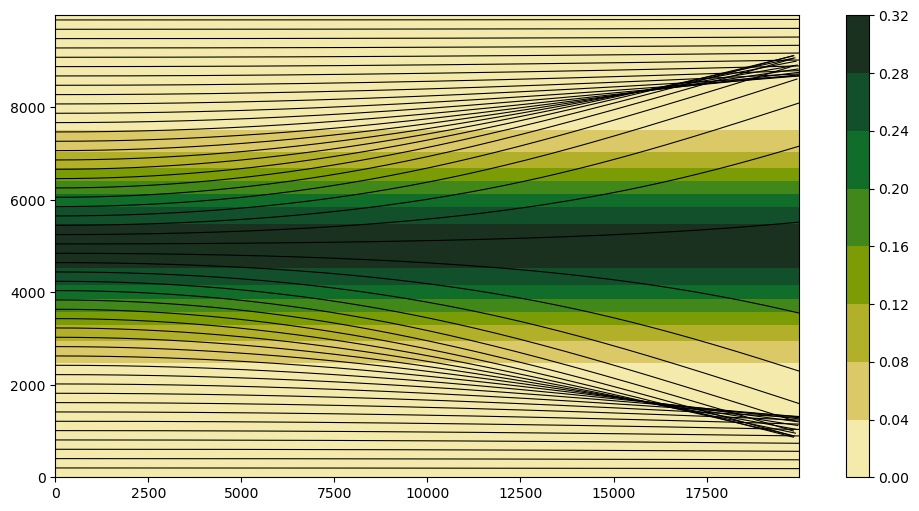

In [ ]:
X = ds_jet.x
Y = ds_jet.y
U = (ds_jet.u**2 + ds_jet.v**2)**.5

pyp.figure(figsize=(12, 6))

cf = pyp.contourf(X, Y, U, cmap=cmocean.cm.speed)

for i in range(bando_jet.ray.size)[::2]:
    ray = bando_jet.isel(ray=i)
    pyp.plot(ray.x, ray.y, 'k', lw=.78)

pyp.colorbar(cf)

## Mesoscale Eddy

In [ ]:
eddy = dir+'currents/eddy.nc'

The grid spacing and initial wave conditions are the same, so we don't recalculate the step size or duration. We use the same constant bathymetry field.

In [ ]:
bando_eddy = mantaray.ray_tracing(x0, y0, Kx0, Ky0, 
                                duration, step_size, 
                                const_bathy, eddy)

In [ ]:
ds_eddy = xr.open_dataset(eddy)

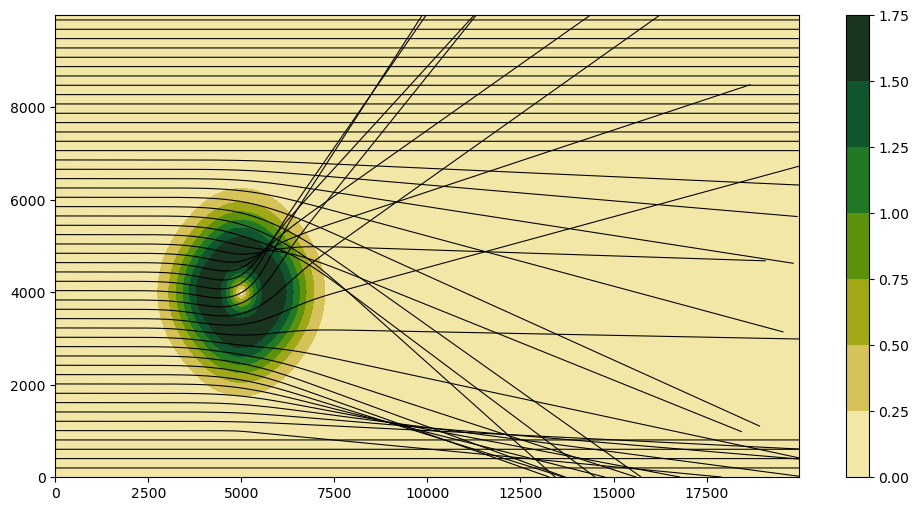

In [34]:
X = ds_eddy.x
Y = ds_eddy.y
U = (ds_eddy.u**2 + ds_eddy.v**2)**.5

pyp.figure(figsize=(12, 6))

cf = pyp.contourf(X, Y, U, cmap=cmocean.cm.speed)

for i in range(bando_eddy.ray.size)[::2]:
    ray = bando_eddy.isel(ray=i)
    pyp.plot(ray.x, ray.y, 'k', lw=.78)

pyp.colorbar(cf)

## Gaussian Island

In [37]:
static_cur = dir+'currents/homogenous.nc'
island     = dir+'bathymetry/island.nc'

In [38]:
bando_island = mantaray.ray_tracing(x0, y0, Kx0, Ky0, 
                                    duration, step_size, 
                                    island, static_cur)

In [39]:
ds_island = xr.open_dataset(island)

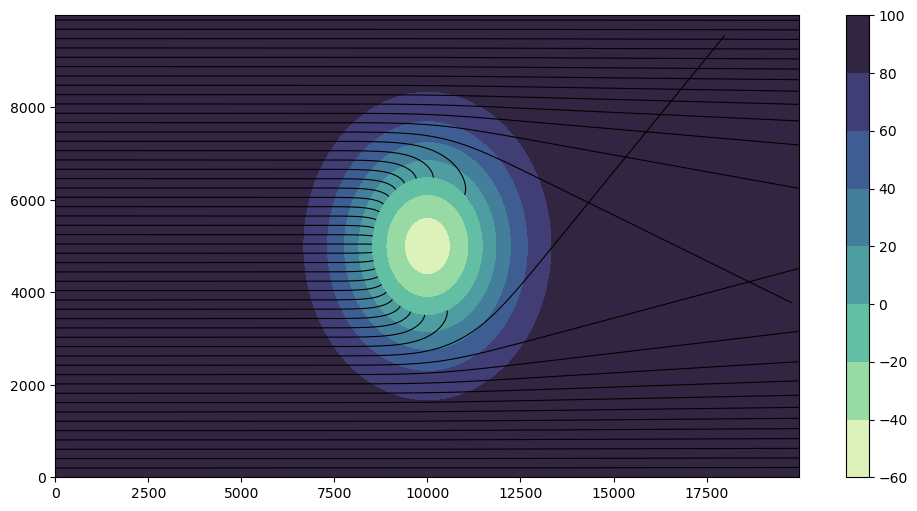

In [40]:
X = ds_eddy.x
Y = ds_eddy.y
H = ds_island.depth

pyp.figure(figsize=(12, 6))

cf = pyp.contourf(X, Y, H, cmap=cmocean.cm.deep)

for i in range(bando_island.ray.size)[::2]:
    ray = bando_island.isel(ray=i)
    pyp.plot(ray.x, ray.y, 'k', lw=.78)

pyp.colorbar(cf)

%%capture???

# Interactive Animations

Any ray tracing exercised can be animated with the custom function below by changing which set of rays is passed.

In [ ]:
X = ds_jet.x
Y = ds_jet.y
U = (ds_jet.u**2 + ds_jet.v**2)**.5
# H = ds_island.depth

In [50]:
anim = animate_rays(X, Y, H, # the background field
                    bando_island,
                    style='bathymetry', ray_sample=3)

/var/folders/30/l7lkprrx2c32s7j5y82c67300000gq/T/ipykernel_60594/213022501.py:24: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  ray, = ax.plot([], [], 'k', lw=0.78, color='white')


WARNING: this cell make take some time to compute.

In [51]:
HTML(anim.to_jshtml())

## BONUS: Concertina Effect

In [82]:
ds_cncrt = xr.open_dataset(dir+'currents/concertina.nc')

In [83]:
x = ds_cncrt.x.values
y = ds_cncrt.y.values

In [84]:
step_size = compute_cfl(x, y, k0)
duration  = compute_duration(x, k0)

In [85]:
concertina  = dir+'currents/concertina.nc'
const_bathy = dir+'bathymetry/constant.nc'

In [86]:
x0 = 10*np.ones(n_rays)
y0 = np.linspace(0, y.max(), n_rays)

In [87]:
bando_cncrt = mantaray.ray_tracing(x0, y0, Kx0, Ky0, 
                                    duration, step_size, 
                                    const_bathy, concertina)

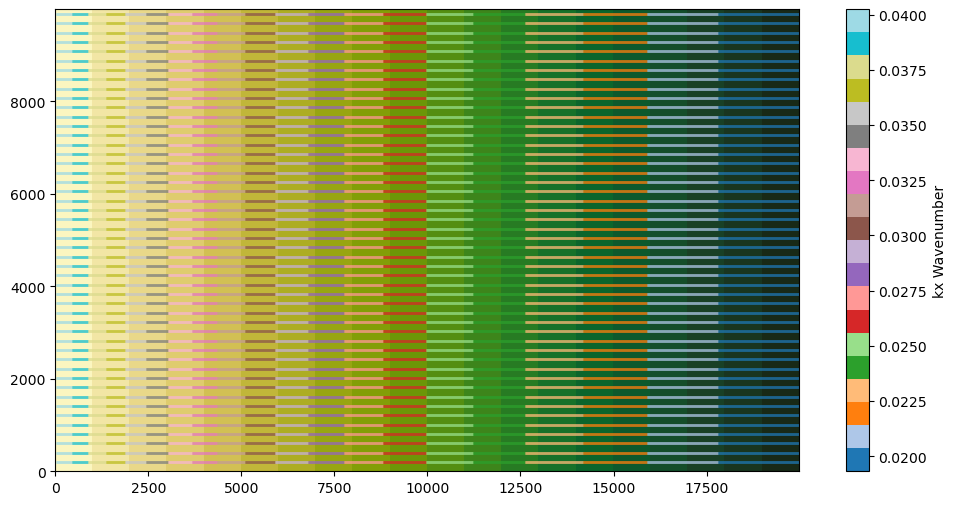

In [137]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.collections as mcollections
import cmocean

fig, ax = plt.subplots(figsize=(12, 6))

# Plot background contour
cf = ax.contourf(X, Y, U, cmap=cmocean.cm.speed, alpha=1, levels=20)

# Colormap for wavenumber
cmap = 'tab20'#cmocean.cm.phase  # Choose an appropriate colormap

segments = []
colors = []
midpoints_x = []
midpoints_y = []

for i in range(bando_cncrt.ray.size)[::2]:  # Skip every other ray for clarity
    ray = bando_cncrt.isel(ray=i)
    
    # Stack x, y coordinates as line segments
    points = np.column_stack([ray.x.values, ray.y.values])
    
    # Create segments from consecutive points
    for j in range(len(points) - 1):
        segment = points[j:j+2]
        segments.append(segment)
        
        # Assign color based on wavenumber at segment start
        colors.append(ray.kx.values[j])
        
        # Calculate midpoint
        mid_x = (segment[0, 0] + segment[1, 0]) / 2
        mid_y = (segment[0, 1] + segment[1, 1]) / 2
        midpoints_x.append(mid_x)
        midpoints_y.append(mid_y)

# Convert to NumPy arrays
colors = np.array(colors)

# Normalize colormap based on plotted rays
normie = plt.Normalize(vmin=np.nanmin(colors), vmax=np.nanmax(colors))

# Create a LineCollection from segments
lc = mcollections.LineCollection(segments, cmap=cmap, norm=normie, linewidth=2)
lc.set_array(colors)  # Assign color array

ax.add_collection(lc)  # Add colored lines to the plot
fig.colorbar(lc, ax=ax, label='kx Wavenumber')  # Add colorbar

# Add ticks (small markers) at segment midpoints
# ax.scatter(midpoints_x, midpoints_y, color='black', s=1, marker='|', zorder=3)

plt.show()


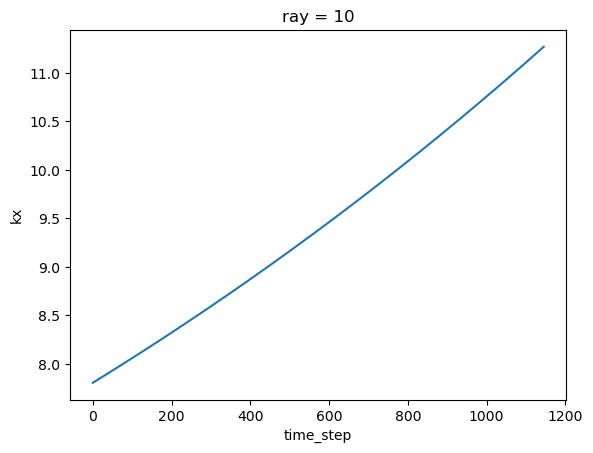

In [66]:
group_velocity(bando_cncrt.sel(ray=10)['kx']).plot()

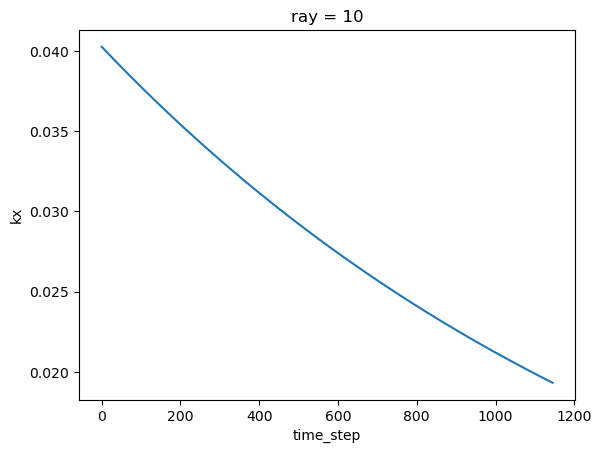

In [67]:
bando_cncrt.sel(ray=10)['kx'].plot()

## BONUS: A Gentle Beach

For this example, rays must start at an angle.

In [244]:
theta0 = np.deg2rad(35)

# Calculate wavenumber components
kx0 = k0*np.cos(theta0)
ky0 = k0*np.sin(theta0)

In [245]:
n_rays = 50

# Initialize wavenumber for all rays
Kx0 = kx0*np.ones(n_rays)
Ky0 = ky0*np.ones(n_rays)

In [246]:
step_size = compute_cfl(x, y, k0)
duration  = compute_duration(x, k0)

In [257]:
# Parameters
x_start = 5000  # Start x coordinate (m)
y_start = 10    # Start y coordinate (m)
line_length = 5000  # Total length of the line (m)

# Calculate the step size in the x and y directions
dx = -line_length / n_rays * np.cos(np.pi/2 - theta0)
dy = line_length / n_rays * np.sin(np.pi/2 - np.pi/4)

# Generate the coordinates along the line
x0 = x_start + np.linspace(0, dx*(n_rays-1), n_rays)  # x coordinates
y0 = y_start + np.linspace(0, dy*(n_rays-1), n_rays)  # y coordinates

In [258]:
const = dir+'currents/homogenous.nc'
beach = dir+'bathymetry/beach.nc'

In [259]:
bando_beach = mantaray.ray_tracing(x0, y0, Kx0, Ky0, 
                                duration, step_size, 
                                beach, const)

In [260]:
ds_beach = xr.open_dataset(beach)

/var/folders/30/l7lkprrx2c32s7j5y82c67300000gq/T/ipykernel_98030/583403314.py:13: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "k" (-> color=(0.0, 0.0, 0.0, 1)). The keyword argument will take precedence.
  pyp.plot(ray.x, ray.y, 'k', lw=.78, color='white')


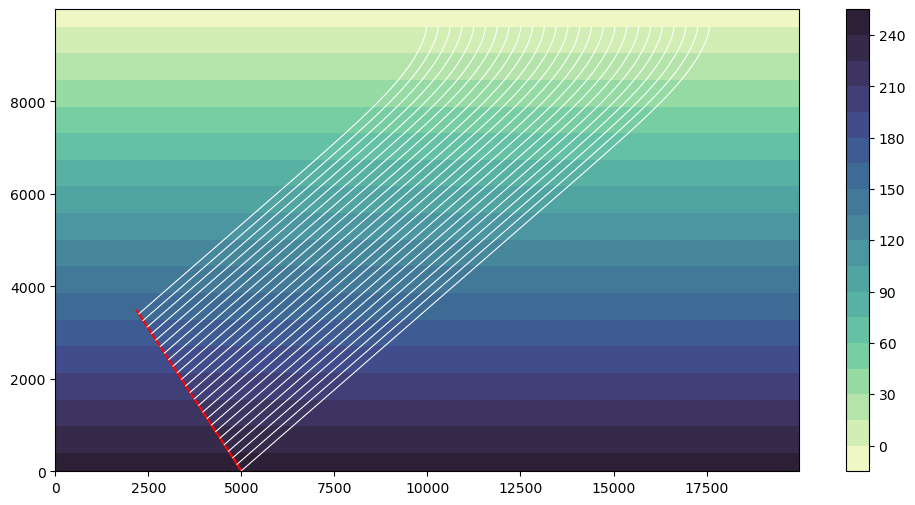

In [261]:
X = ds_beach.x
Y = ds_beach.y
H = ds_beach.depth

pyp.figure(figsize=(12, 6))

cf = pyp.contourf(X, Y, H, cmap=cmocean.cm.deep, levels=20)
line = pyp.plot(x0, y0, label="Line at points (x0, y0)", color='red')


for i in range(bando_beach.ray.size)[::2]:
    ray = bando_beach.isel(ray=i)
    pyp.plot(ray.x, ray.y, 'k', lw=.78, color='white')

pyp.colorbar(cf)